In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import re
from scipy import stats

from wordcloud import ImageColorGenerator, WordCloud
from argostranslate import package, translate
import jieba
from PIL import Image

from urllib.request import quote
import requests
import folium
from folium import plugins
from folium.plugins import HeatMap

from sklearn import metrics
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import StratifiedShuffleSplit

In [2]:
mpl.rcParams['figure.figsize'] = [20, 10]
mpl.rcParams['font.size'] = 14

In [3]:
data = pd.read_csv('./output.csv', encoding='gbk')
len(data)

21629

In [4]:
# data.drop(index=data[data['house_type'] == 'house_type'].index, inplace=True)
data = data.drop_duplicates(subset=['house_code'])
len(data)

12701

In [5]:
def get_num(row):
    area = re.findall(r'\d+', row['area'])
    row['area'] = int(area[0]) if area else np.nan
    floor = re.findall(r'\d+', row['floor'])
    row['floor'] = int(floor[0]) if floor else np.nan
    price = re.findall(r'\d+', row['price'])
    row['price'] = int(price[0]) if price else np.nan
    return row

In [6]:
data = data.apply(get_num, axis=1)

In [7]:
def get_house_type(row):
    room = re.findall(r'\d*室', row['house_type'])
    room_num = re.findall(r'\d+', room[0])
    row['bedroom'] = int(room_num[0]) if room_num else np.nan
    hall = re.findall(r'\d+厅', row['house_type'])
    hall_num = re.findall(r'\d+', hall[0])
    row['living room'] = int(hall_num[0]) if hall_num else np.nan
    rest_room = re.findall(r'\d+卫', row['house_type'])
    rest_room_num = re.findall(r'\d+', rest_room[0])
    row['bathroom'] = int(rest_room_num[0]) if rest_room_num else np.nan
    return row

In [8]:
data = data.apply(get_house_type, axis=1)

In [9]:
data['district'] = data['location'].map(lambda x: x.split('-')[0])

In [10]:
def get_facility(row):
    if row['facility'] is not np.nan:
        facility = row['facility'].split(',')
        row[facility] = 1
        return row
    else:
        return row

In [11]:
data[['洗衣机', '空调', '衣柜', '电视', '冰箱', '热水器', '床', '暖气', '宽带', '天然气']] = 0
data = data.apply(get_facility, axis=1)
rename = {
    '洗衣机': 'Washing Machine', 
    '空调': 'Air Conditioner', 
    '衣柜': 'Wardrobe', 
    '电视': 'Television', 
    '冰箱': 'Refrigerator', 
    '热水器': 'Water Heater', 
    '床': 'Bed', 
    '暖气': 'Heating', 
    '宽带': 'Broadband', 
    '天然气': 'Natural Gas'
}
data.rename(columns=rename, inplace=True)

In [12]:
data['elevator'] = data['elevator'].apply(lambda x: 1 if x == '有' else 0)
data['fuel_gas'] = data['fuel_gas'].apply(lambda x: 1 if x == '有' else 0)
data['heating'] = data['heating'].apply(lambda x: 1 if x == '有' else 0)

In [13]:
district_mapping = {
    '香洲区': 'Xiangzhou District',
    '高新区': 'High-Tech District',
    '横琴区': 'Hengqin District',
    '斗门区': 'Doumen District',
    '金湾区': 'Jinwan District'
}
data['district'] = data['district'].replace(district_mapping)

In [14]:
data.head()

,area,description,electricity,elevator,facility,floor,fuel_gas,heating,house_code,house_type,...,Washing Machine,Air Conditioner,Wardrobe,Television,Refrigerator,Water Heater,Bed,Heating,Broadband,Natural Gas
0,90.0,NaN,商电,1,NaN,16,0,0,ZH2870119122161901568,1室1厅1卫,...,0,0,0,0,0,0,0,0,0,0
1,80.0,NaN,商电,1,NaN,43,0,0,ZH1723295734255583232,1室0厅0卫,...,0,0,0,0,0,0,0,0,0,0
2,68.0,NaN,商电,1,NaN,16,0,0,ZH1828033518710554624,1室1厅1卫,...,0,0,0,0,0,0,0,0,0,0
3,38.0,NaN,民电,1,NaN,23,1,0,ZH1831181211553234944,1室0厅1卫,...,0,0,0,0,0,0,0,0,0,0
4,96.0,NaN,商电,1,NaN,43,0,0,ZH1792927117734838272,1室0厅0卫,...,0,0,0,0,0,0,0,0,0,0


In [22]:
data.to_csv('rent_data.csv', index=False, encoding="gbk")

## statistics

In [15]:
data['district'].value_counts()

district
Xiangzhou District    5160
High-Tech District    2622
Jinwan District       2067
Doumen District       1690
Hengqin District      1162
Name: count, dtype: int64

In [16]:
data['house_type'].value_counts().head()

house_type
3室2厅2卫    3391
3室2厅1卫    1743
1室1厅1卫    1369
4室2厅2卫    1336
2室2厅1卫    1279
Name: count, dtype: int64

In [17]:
data['elevator'].map({1: 'have elevator', 0: 'no elevator'}).value_counts()

elevator
have elevator    8224
no elevator      4477
Name: count, dtype: int64

## Group

In [26]:
data.groupby('district')['price'].mean().sort_values(ascending=False)
data.groupby('bedroom')['price'].mean().sort_values(ascending=False)
grouped = data.groupby(['district', 'bedroom'], as_index= False)['price'].mean()
grouped_pivot = grouped.pivot(index='district', columns='bedroom', values='price')
grouped_pivot

bedroom,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0
district,,,,,,,,,,,,
Doumen District,2534.874372,1494.710425,1898.983657,2761.048673,5405.882353,7250.000000,1250.000000,NaN,35200.000000,NaN,NaN,NaN
Hengqin District,8610.358566,5073.056000,5674.737430,7545.789474,30370.000000,NaN,19200.000000,60000.000000,NaN,NaN,NaN,NaN
High-Tech District,3368.252101,3092.586777,3424.036853,4933.213894,14588.297872,25750.000000,37116.500000,45000.000000,23000.000000,NaN,35000.0,NaN
Jinwan District,5382.968531,2013.732794,2366.939236,3218.145658,4114.166667,10500.000000,NaN,32000.000000,38000.000000,NaN,NaN,NaN
Xiangzhou District,5224.749204,3402.552930,4027.124498,6849.912313,13284.528302,18822.222222,19770.928571,24383.333333,35941.666667,29000.0,NaN,132000.0


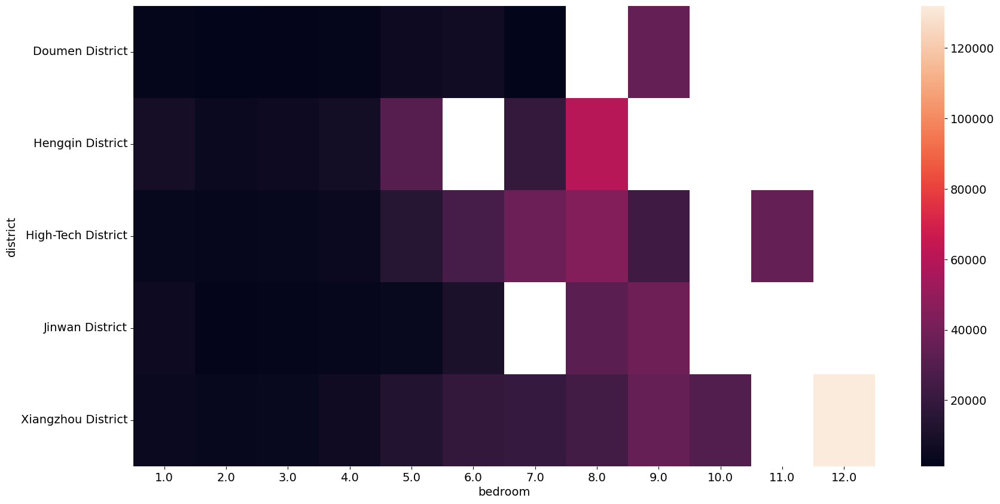

In [27]:
heatmap_plot=sns.heatmap(grouped_pivot)

In [28]:
# Extracting the specified columns for correlation analysis
area = data.iloc[:, 0]  # '面积' is the first column
floor = data.iloc[:, 5]  # '楼层' is the sixth column
rooms = data.iloc[:, 18]  # '室' is the nineteenth column
price = data.iloc[:, 13]  # '价格' is the fourteenth column

# Creating a new DataFrame with the selected columns
selected_data = pd.DataFrame({
    '面积': area,
    '楼层': floor,
    '室': rooms,
    '价格': price
})

# Calculate the correlation matrix
correlation_matrix = selected_data.corr()['价格']

correlation_matrix



面积    0.654185
楼层   -0.015933
室     0.068806
价格    1.000000
Name: 价格, dtype: float64

In [29]:
selected_data = data[['price', 'area', 'bedroom', 'living room', 'bathroom','Washing Machine','Air Conditioner', 'Wardrobe', 'Television', 'Refrigerator', 'Water Heater', 'Bed', 'Heating', 'Broadband', 'Natural Gas']]
correlation = selected_data.corr()
sorted_correlation = correlation["price"].sort_values(ascending=False)
sorted_correlation

price              1.000000
area               0.654185
bedroom            0.068806
bathroom           0.031417
Heating            0.006425
Broadband          0.003078
Natural Gas       -0.025471
Television        -0.030612
Air Conditioner   -0.037175
Refrigerator      -0.042860
Wardrobe          -0.043394
Washing Machine   -0.044115
Water Heater      -0.045959
Bed               -0.049031
living room       -0.076815
Name: price, dtype: float64

In [30]:
mask = ~np.logical_or(np.isnan(data['area']), np.isnan(data['price']))
pearson_coef, p_value = stats.pearsonr(data['area'][mask], data['price'][mask])
print ("The Pearson Correlation Coefficient is", pearson_coef, "\nwith a P-value of P =", p_value)

The Pearson Correlation Coefficient is 0.6541854531883052 
with a P-value of P = 0.0


## visualization

### area

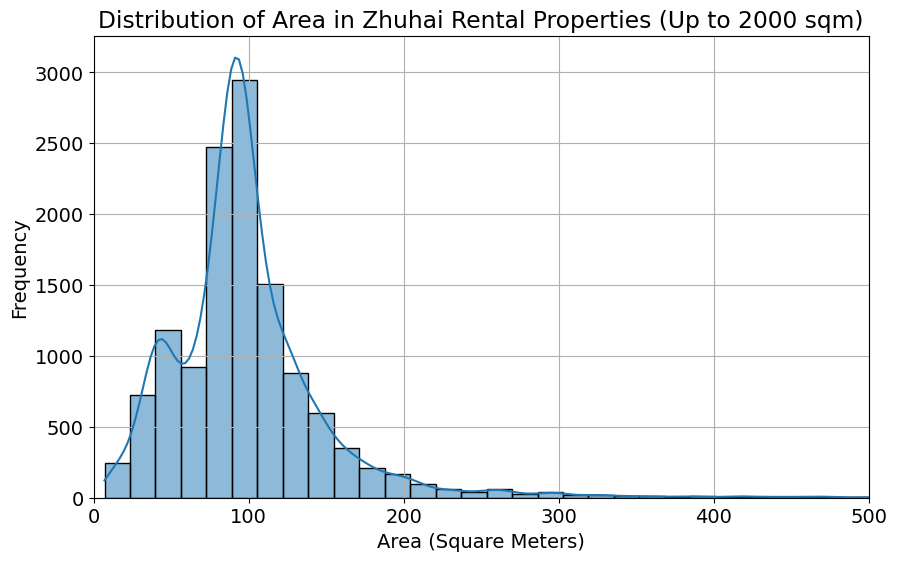

In [31]:
plt.figure(figsize=(10, 6))
sns.histplot(data[data['area'] <= 500]['area'], kde=True, bins=30)
plt.title('Distribution of Area in Zhuhai Rental Properties (Up to 2000 sqm)')
plt.xlabel('Area (Square Meters)')
plt.ylabel('Frequency')
plt.xlim(0, 500)  # Limiting x-axis to 2000
plt.grid(True)
plt.show()

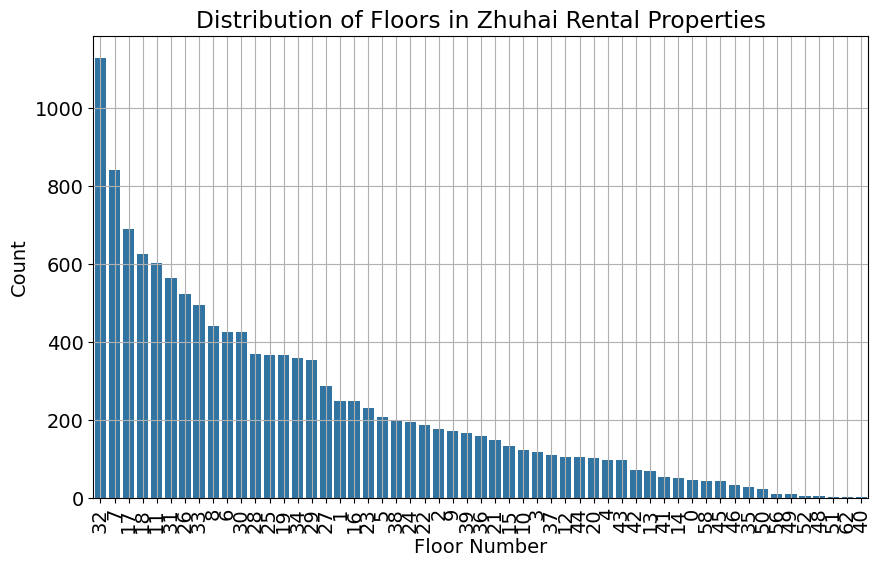

In [32]:
# Check if 'floor' column exists in the dataset
if 'floor' in data.columns:
    # Plotting the distribution of the 'floor' column
    plt.figure(figsize=(10, 6))
    sns.countplot(x='floor', data=data, order = data['floor'].value_counts().index)
    plt.title('Distribution of Floors in Zhuhai Rental Properties')
    plt.xlabel('Floor Number')
    plt.ylabel('Count')
    plt.xticks(rotation=90)  # Rotating the x-axis labels for better readability
    plt.grid(True)
    plt.show()
else:
    floor_column_exists = False
    data.columns



## WordClould

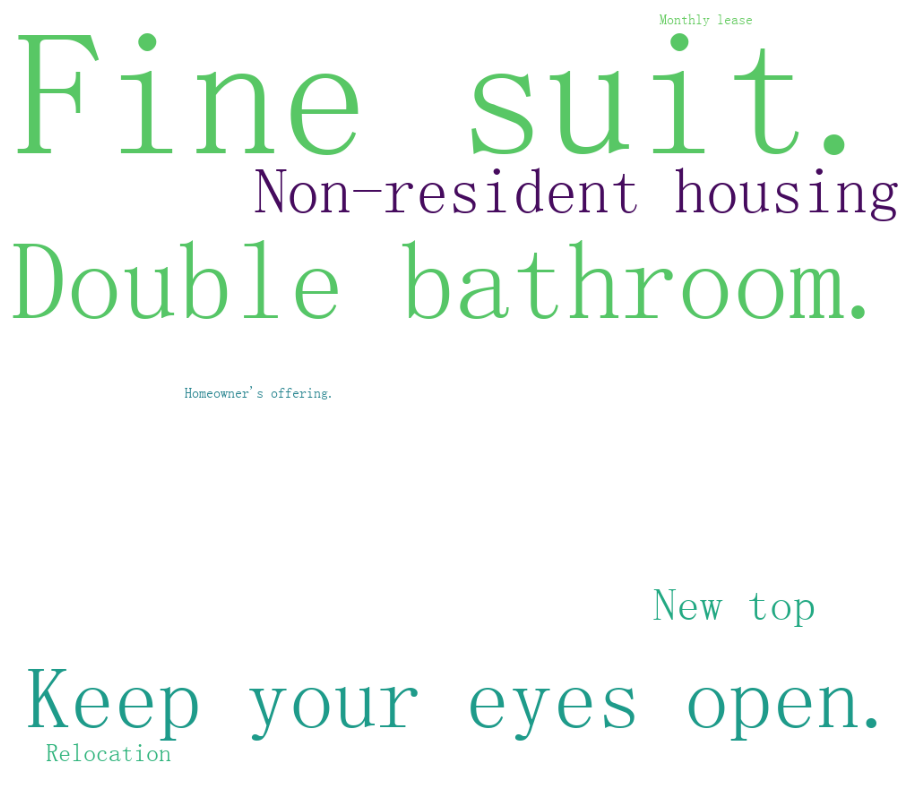

In [18]:
tags =','.join([tag for tag in data['tags'].ravel() if tag is not np.nan])
tags = pd.Series(tags.split(','))
tags_counts = tags.value_counts()

for index in tags_counts.index:
    translation = translate.translate(index, 'zh', 'en')
    tags_counts = tags_counts.rename(index={index: translation})


wc = WordCloud(
    font_path='./simsun.ttf',
    background_color="white",  
    # mask=bg,   # shape
    max_words=2000,  
    max_font_size=300, 
    random_state=42,
    width=1000, height=860, margin=2,
)
wc.generate_from_frequencies(tags_counts)
plt.figure()

plt.imshow(wc)
plt.axis("off")
plt.show()

Building prefix dict from the default dictionary ...
Loading model from cache C:\Users\magne\AppData\Local\Temp\jieba.cache


Loading model cost 0.717 seconds.
Prefix dict has been built successfully.


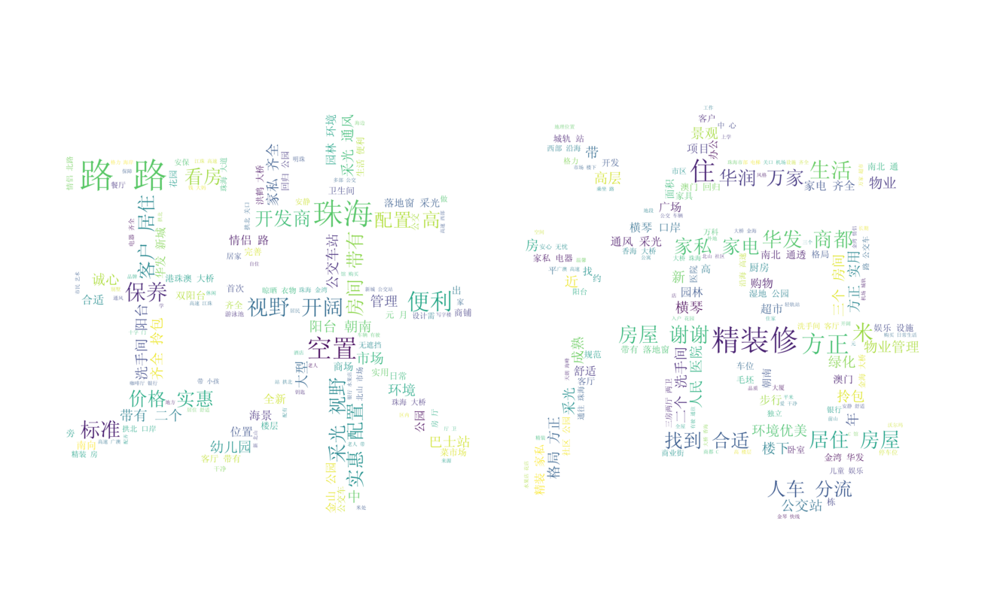

In [19]:
stopwords1 = [line.strip() for line in open('./all_stopwords.txt', 'r', encoding='gbk').readlines()]
stopwords2 = [
    '房源', '亮点', '描述', '此房', '介绍', '原因', '房东', '号线', '就是', '东门', '北门', '旁边', '业主',
    '房子', '出租', '周边', '配套', '装修', '交通', '出行', '上海', '可以', '即可', '到达', '数据', '来源于',
    '一兆', '韦德', '租客', '到期', '来自', '百度', '所以', '位于', '公里', '内部', '希望', '城市', '有限公司',
    '适合', '出来', '地下', '便是', '直接', '小时', '两个', '充足', '小区', '出门', '距离', '户型', '两房',
    '一房', '比较', '高德', '地图', '百度', '中间', '提供', '直达', '同意', '里面', '十分', '门口', '欢迎',
    '二房', '正气', '一个', '满足', '各种', '多条', '一条街', '自己', '米左右', '三房', '之前', '目前', '以及',
    '左右', '本房', '不错', '等等', '需求', '现在', '上海市', '自带', '路上', '选择', '入住', '属于', '号口'
]
stopwords = stopwords1 + stopwords2
description = '。'.join(data['description'][data['description'].astype(str) != 'nan'].to_list())
seg_list = jieba.cut(description, cut_all=False)
seg_list = ' '.join(seg_list)
bg = np.array(Image.open("./zhuhai.jpg"))
wc = WordCloud(
    font_path='./simsun.ttf',
    background_color="white",
    mask=bg,   
    max_words=2000, 
    max_font_size=1000, 
    stopwords=stopwords,
    scale=14,   
    random_state=42,
    width=1000, height=860, margin=2,
)
wc.generate(seg_list)
plt.figure()
image_colors=ImageColorGenerator(bg)
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

## MAP

### get latitude and longitude

In [20]:
def address(address):
    url = 'http://api.map.baidu.com/geocoding/v3/'
    address = quote(address) 
    city = quote('珠海')
    output='json'
    ak = 'PiMDUtyPRtgygVbyMB4MKqLXmEY9w1Sk'
    uri = url + '?address=' + address + '&output=' + output + '&ak=' + ak + '&city=' + city
    req = requests.get(uri)
    temp = req.json()
    lat = temp['result']['location']['lat']  
    lng = temp['result']['location']['lng']  
    print(lat,lng)
    return lat, lng

In [21]:
def get_latitude_longitude(row):
    row['latitude'], row['longitude'] = address(row['location'])
    return row



### Because of the quota of Baidu Map api, you can use my "latitude_longitude_data.csv" data set

In [64]:
# data.iloc[:5000] = data.iloc[:5000].apply(get_latitude_longitude, axis=1)
# data = data.apply(get_latitude_longitude, axis=1)

22.1402260349148 113.35914935036075
22.141191601479104 113.34858375044753
22.13473882487215 113.35384296988452
22.149522797635186 113.36192035336647
22.14208995652007 113.35775598868469
22.137984960659214 113.3577993768408
22.138157120497855 113.35640098465389
22.136199992897108 113.35154788913783
22.142055307942368 113.358996458763
22.136199992897108 113.35154788913783
22.139737037999918 113.35518112182073
22.149522797635186 113.36192035336647
22.141191601479104 113.34858375044753
22.141191601479104 113.34858375044753
22.13553209923101 113.3433159971082
22.142055307942368 113.358996458763
22.14591195971644 113.35573102840476
22.13833296268012 113.34804845019431
22.136199992897108 113.35154788913783
22.13553209923101 113.3433159971082
22.14208995652007 113.35775598868469
22.149522797635186 113.36192035336647
22.139950014048814 113.3523199827234
22.139950014048814 113.3523199827234
22.13708172480378 113.35273994054917
22.137984960659214 113.3577993768408
22.13553209923101 113.3433159971

In [65]:
# data.to_csv('latitude_longitude_data.csv', index=False, encoding="gbk")

### I actually got the latitude and longitude several times separately due to api limits, and you can just read "latitude_longitude_data.csv" and go on

In [22]:
data = pd.read_csv('./latitude_longitude_data.csv', encoding='gbk')
len(data)

12701

### Housing distribution

In [23]:
zh_map = folium.Map(location=[22.059026975521572, 113.13882052071243])
# Instantiate a feature group for the house in the dataframe
house = folium.map.FeatureGroup()
for lat, lng, in zip(data['latitude'], data['longitude']):
    _ = house.add_child(
        folium.Circle(
            [lat, lng],
            radius=2, # define how big you want the circle markers to be
            color='red',
            opacity=0.4
        )
    )
zh_map.add_child(house)

### Listings by region​



In [24]:
zh_map = folium.Map(location=[22.35620618600249, 113.60266739775818])
# instantiate a mark cluster object for the house in the dataframe
house = plugins.MarkerCluster().add_to(zh_map)
# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(data['latitude'], data['longitude'], pd.Categorical(data['district'])):
    _ = folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(house)
# add incidents to map
zh_map.add_child(house)

### Heatmap

In [25]:
zh_map = folium.Map(location=[22.059026975521572,113.13882052071243])
heatdata = data[['latitude','longitude']].values.tolist()
HeatMap(heatdata, radius=15).add_to(zh_map)
zh_map

## Predict

In [42]:

data['electricity'] = data['electricity'].replace({'商电': 0, '民电': 1})

data['water'] = data['water'].replace({'商水': 0, '民水': 1})

data = data[data['electricity'] != '暂无数据']
data = data[data['water'] != '暂无数据']
data.head()


,area,description,electricity,elevator,facility,floor,fuel_gas,heating,house_code,house_type,...,Wardrobe,Television,Refrigerator,Water Heater,Bed,Heating,Broadband,Natural Gas,latitude,longitude
0,90.0,NaN,0,1,NaN,16,0,0,ZH2870119122161901568,1室1厅1卫,...,0,0,0,0,0,0,0,0,22.119413,113.553710
1,80.0,NaN,0,1,NaN,43,0,0,ZH1723295734255583232,1室0厅0卫,...,0,0,0,0,0,0,0,0,22.160909,113.530892
2,68.0,NaN,0,1,NaN,16,0,0,ZH1828033518710554624,1室1厅1卫,...,0,0,0,0,0,0,0,0,22.119413,113.553710
3,38.0,NaN,1,1,NaN,23,1,0,ZH1831181211553234944,1室0厅1卫,...,0,0,0,0,0,0,0,0,22.163561,113.529109
4,96.0,NaN,0,1,NaN,43,0,0,ZH1792927117734838272,1室0厅0卫,...,0,0,0,0,0,0,0,0,22.160909,113.530892


In [43]:
data.drop(columns=['description', 'facility', 'stall',	'tags',	'title', 'heating',	'house_code',	'house_type',	'lease',	'location',	'orientation'], inplace=True)
# data.corr()["price"].sort_values(ascending=False)
# , 'stall',	'tags',	'title', 'heating',	'house_code',	'house_type',	'lease',	'location',	'orientation'

In [44]:
selected_data = data[['price', 'area', 'bedroom', 'living room', 'bathroom','Washing Machine','Air Conditioner', 'Wardrobe', 'Television', 'Refrigerator', 'Water Heater', 'Bed', 'Heating', 'Broadband', 'Natural Gas', 'latitude', 'longitude']]
correlation = selected_data.corr()
sorted_correlation = correlation["price"].sort_values(ascending=False)
sorted_correlation

price              1.000000
area               0.755054
longitude          0.152019
bedroom            0.108450
bathroom           0.102357
Heating            0.010967
Broadband          0.000299
Natural Gas       -0.005121
Television        -0.021557
Air Conditioner   -0.029292
Refrigerator      -0.034939
Water Heater      -0.035667
Washing Machine   -0.036256
Wardrobe          -0.038319
Bed               -0.043877
living room       -0.044947
latitude          -0.062198
Name: price, dtype: float64

In [45]:
data.columns

Index(['area', 'electricity', 'elevator', 'floor', 'fuel_gas', 'price',
       'water', 'bedroom', 'living room', 'bathroom', 'district',
       'Washing Machine', 'Air Conditioner', 'Wardrobe', 'Television',
       'Refrigerator', 'Water Heater', 'Bed', 'Heating', 'Broadband',
       'Natural Gas', 'latitude', 'longitude'],
      dtype='object')

In [46]:
model_data = data[(data['price'] >= 1000) & (data['price'] <= 12000)].copy()

In [47]:
num = model_data[['area', 'bedroom', 'living room', 'bathroom', 'floor']]
onehot = model_data[['electricity','water','Washing Machine', 'Air Conditioner', 'Wardrobe', 'Television',
       'Refrigerator', 'Water Heater', 'Bed', 'Heating', 'Broadband',
       'Natural Gas']]

In [48]:
scaler = StandardScaler()
data_num = scaler.fit_transform(num)
data_num.shape

(5982, 5)

In [49]:
y_data = model_data['price'].to_numpy() / 10000

In [50]:
enc = OneHotEncoder(sparse=False)
data_onehot = enc.fit_transform(onehot)
data_onehot.shape

d:\project\group\Predict-house-rent-with-neutral-network-master\venv\Lib\site-packages\sklearn\preprocessing\_encoders.py:975: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


(5982, 24)

In [51]:
X_data = np.concatenate((data_num, data_onehot), axis=1)
X_data = np.nan_to_num(X_data)
X_data.shape

(5982, 29)

(0.0, 200.0)

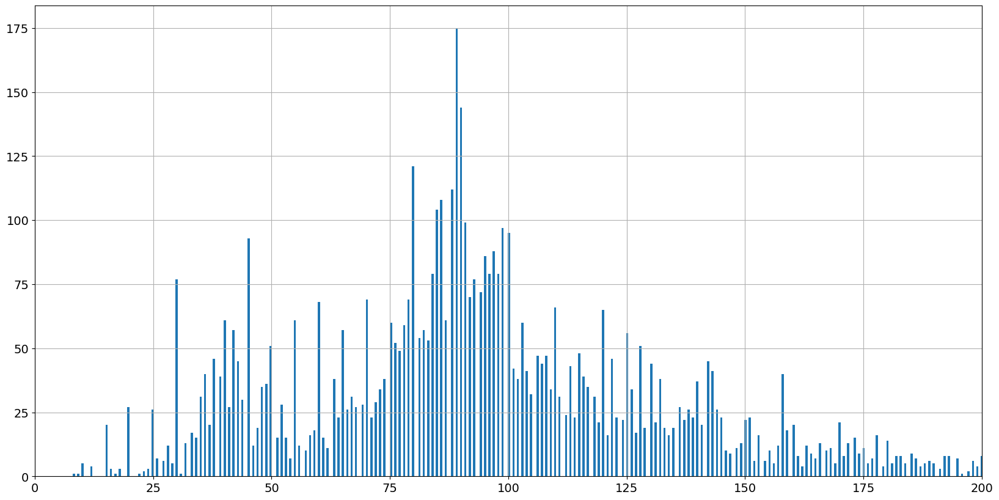

In [54]:
model_data['area'].hist(bins=1000)
plt.xlim(0, 200)

<Axes: >

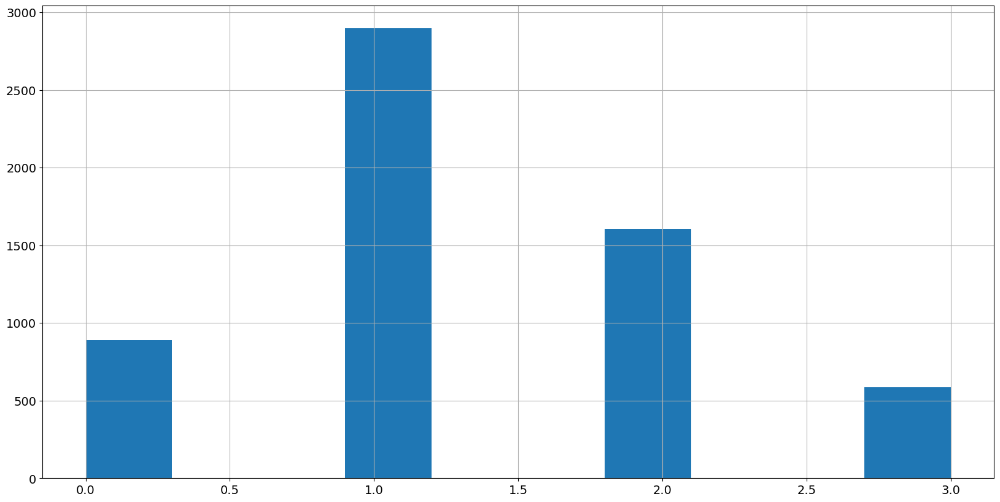

In [55]:
model_data['area_cut'] = pd.cut(model_data['area'], [0, 50, 100, 150, np.inf], labels=False)
model_data['area_cut'].hist()

In [56]:
sss = StratifiedShuffleSplit(n_splits=1, random_state=27)
for train_index, test_index in sss.split(model_data, model_data['area_cut']):
    X_train = X_data[train_index]
    y_train = y_data[train_index]
    X_test = X_data[test_index]
    y_test = y_data[test_index]

ValueError: Input y contains NaN.